In [1]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import sklearn

In [2]:
weather_df = pd.read_csv("weatherHistory.csv")
weather_df.head()

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary
0,2006-04-01 00:00:00.000 +0200,Partly Cloudy,rain,9.472222,7.388889,0.89,14.1197,251.0,15.8263,0.0,1015.13,Partly cloudy throughout the day.
1,2006-04-01 01:00:00.000 +0200,Partly Cloudy,rain,9.355556,7.227778,0.86,14.2646,259.0,15.8263,0.0,1015.63,Partly cloudy throughout the day.
2,2006-04-01 02:00:00.000 +0200,Mostly Cloudy,rain,9.377778,9.377778,0.89,3.9284,204.0,14.9569,0.0,1015.94,Partly cloudy throughout the day.
3,2006-04-01 03:00:00.000 +0200,Partly Cloudy,rain,8.288889,5.944444,0.83,14.1036,269.0,15.8263,0.0,1016.41,Partly cloudy throughout the day.
4,2006-04-01 04:00:00.000 +0200,Mostly Cloudy,rain,8.755556,6.977778,0.83,11.0446,259.0,15.8263,0.0,1016.51,Partly cloudy throughout the day.


In [3]:
weather_df.describe(include = 'all')

,Formatted Date,Summary,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars),Daily Summary
count,96453,96453,95936,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000,96453.000000,96453.0,96453.000000,96453
unique,96429,27,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,214
top,2010-08-02 22:00:00.000 +0200,Partly Cloudy,rain,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Mostly cloudy throughout the day.
freq,2,31733,85224,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,20085
mean,NaN,NaN,NaN,11.932678,10.855029,0.734899,10.810640,187.509232,10.347325,0.0,1003.235956,NaN
std,NaN,NaN,NaN,9.551546,10.696847,0.195473,6.913571,107.383428,4.192123,0.0,116.969906,NaN
min,NaN,NaN,NaN,-21.822222,-27.716667,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,NaN
25%,NaN,NaN,NaN,4.688889,2.311111,0.600000,5.828200,116.000000,8.339800,0.0,1011.900000,NaN
50%,NaN,NaN,NaN,12.000000,12.000000,0.780000,9.965900,180.000000,10.046400,0.0,1016.450000,NaN
75%,NaN,NaN,NaN,18.838889,18.838889,0.890000,14.135800,290.000000,14.812000,0.0,1021.090000,NaN


In [4]:
weather_df.shape

(96453, 12)

In [5]:
weather_df.isna().sum()

Formatted Date                0
Summary                       0
Precip Type                 517
Temperature (C)               0
Apparent Temperature (C)      0
Humidity                      0
Wind Speed (km/h)             0
Wind Bearing (degrees)        0
Visibility (km)               0
Loud Cover                    0
Pressure (millibars)          0
Daily Summary                 0
dtype: int64

In [6]:
weather_df = weather_df.dropna()

In [7]:
weather_df.isna().sum()

Formatted Date              0
Summary                     0
Precip Type                 0
Temperature (C)             0
Apparent Temperature (C)    0
Humidity                    0
Wind Speed (km/h)           0
Wind Bearing (degrees)      0
Visibility (km)             0
Loud Cover                  0
Pressure (millibars)        0
Daily Summary               0
dtype: int64

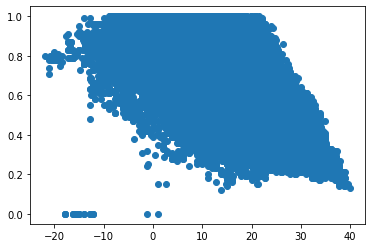

In [8]:
from matplotlib import pyplot
pyplot.scatter(weather_df["Temperature (C)"], weather_df.Humidity)
pyplot.show()

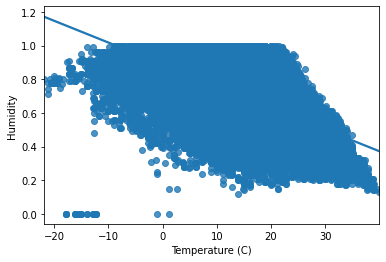

In [9]:
import seaborn as sns
sns.regplot(x = "Temperature (C)",
y = "Humidity",data =  weather_df)
plt.show() 

In [10]:
simple_linear_reg_df = weather_df[['Humidity', 'Temperature (C)']].sample(15, random_state=2)

&lt;AxesSubplot:xlabel=&#39;Humidity&#39;, ylabel=&#39;Temperature (C)&#39;&gt;

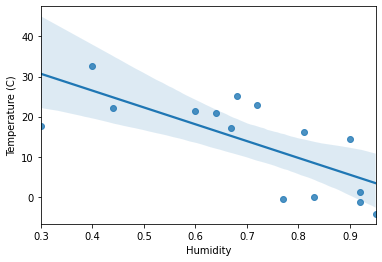

In [11]:
sns.regplot(x="Humidity", y="Temperature (C)",
            data=simple_linear_reg_df)

In [12]:
weather_df.corr().round(1)

,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Loud Cover,Pressure (millibars)
Temperature (C),1.0,1.0,-0.6,0.0,0.0,0.4,NaN,-0.0
Apparent Temperature (C),1.0,1.0,-0.6,-0.1,0.0,0.4,NaN,-0.0
Humidity,-0.6,-0.6,1.0,-0.2,0.0,-0.4,NaN,0.0
Wind Speed (km/h),0.0,-0.1,-0.2,1.0,0.1,0.1,NaN,-0.0
Wind Bearing (degrees),0.0,0.0,0.0,0.1,1.0,0.0,NaN,-0.0
Visibility (km),0.4,0.4,-0.4,0.1,0.0,1.0,NaN,0.1
Loud Cover,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Pressure (millibars),-0.0,-0.0,0.0,-0.0,-0.0,0.1,NaN,1.0


In [13]:
weather_df["Temperature (C)"].corr(weather_df.Humidity)

-0.6321477013082646

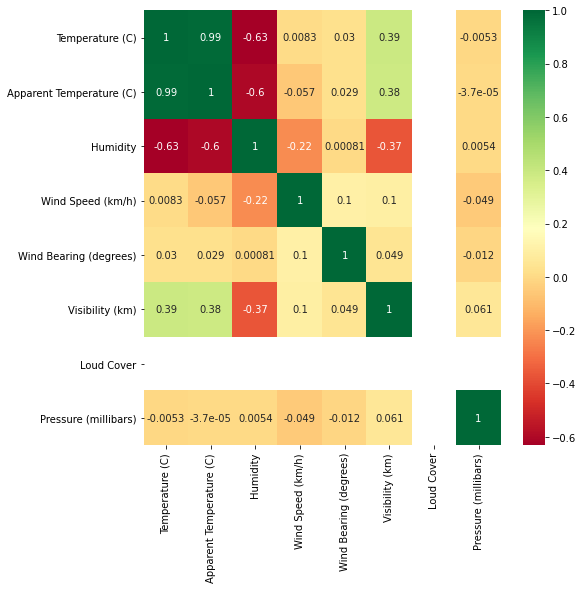

In [14]:
corrmat = weather_df.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(8,8))
g=sns.heatmap(weather_df[top_corr_features].corr(),annot=True,cmap="RdYlGn")

In [15]:
weather_df.columns

Index([&#39;Formatted Date&#39;, &#39;Summary&#39;, &#39;Precip Type&#39;, &#39;Temperature (C)&#39;,
       &#39;Apparent Temperature (C)&#39;, &#39;Humidity&#39;, &#39;Wind Speed (km/h)&#39;,
       &#39;Wind Bearing (degrees)&#39;, &#39;Visibility (km)&#39;, &#39;Loud Cover&#39;,
       &#39;Pressure (millibars)&#39;, &#39;Daily Summary&#39;],
      dtype=&#39;object&#39;)

In [16]:
weather_df['Loud Cover'].unique()

array([0.])

In [17]:
weather_df = weather_df.drop(columns=['Formatted Date', 'Loud Cover', 'Daily Summary', 'Summary'])

In [18]:
weather_df['Precip Type'].unique()

array([&#39;rain&#39;, &#39;snow&#39;], dtype=object)

In [19]:
from sklearn.preprocessing import LabelEncoder 
label_encoder = LabelEncoder()
weather_df['Precip Type'] = label_encoder.fit_transform(weather_df['Precip Type']) 
weather_df.head()

,Precip Type,Temperature (C),Apparent Temperature (C),Humidity,Wind Speed (km/h),Wind Bearing (degrees),Visibility (km),Pressure (millibars)
0,0,9.472222,7.388889,0.89,14.1197,251.0,15.8263,1015.13
1,0,9.355556,7.227778,0.86,14.2646,259.0,15.8263,1015.63
2,0,9.377778,9.377778,0.89,3.9284,204.0,14.9569,1015.94
3,0,8.288889,5.944444,0.83,14.1036,269.0,15.8263,1016.41
4,0,8.755556,6.977778,0.83,11.0446,259.0,15.8263,1016.51


In [20]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
normalised_df = pd.DataFrame(scaler.fit_transform(weather_df), columns=weather_df.columns)
features_df = normalised_df.drop(columns=['Temperature (C)', 'Apparent Temperature (C)'], axis = 1)
target = normalised_df['Temperature (C)']

In [21]:
from sklearn.model_selection import train_test_split

X_train,X_test,y_train,y_test=train_test_split(features_df,target, test_size=0.2,random_state=1)

In [22]:
from sklearn.linear_model import LinearRegression
linear_model = LinearRegression()
linear_model.fit(X_train, y_train)

LinearRegression()

In [23]:
predicted_values = linear_model.predict(X_test)

In [24]:
from sklearn.metrics import mean_absolute_error
mae = mean_absolute_error(y_test, predicted_values)
round(mae, 3) 	

0.08

In [25]:
from sklearn.metrics import r2_score
r2_score = r2_score(y_test, predicted_values)
round(r2_score, 3)

0.605

In [26]:
import numpy as np
rss = np.sum(np.square(y_test - predicted_values))
round(rss, 3)

181.686

In [27]:
from sklearn.metrics import mean_squared_error
mse = mean_squared_error(y_test, predicted_values)
round(mse, 3)

0.009

In [28]:
#RMSE
rmse = np.sqrt(mean_squared_error(y_test, predicted_values))
round(rmse, 3)

0.097